# RCES Final Project with MERRA-2 Data

In this project I am going to use the MERRA-2 reanalysis dataset, produced by NASA GMAO, to diagnose the implied meridional moist static energy transport in the model in the annual mean and zonal mean. Moist static energy 

$$S = C_pT+gz+L_vq$$

is a property of air that sums the energy from the temperature of the air (thermal energy), the moisture content of that air (latent heat), and the gravitational potential energy (height) of the air. I say "implied" transport because rather than calculating the MSE flux from the above quantities directly, I will be using net fluxes of energy into the atmospheric column at the top of the atmosphere (TOA) through shortwave and longwave radiation and at the surface through SW and LW radiation as well as conduction, evaporation, and precipitation. Then, assuming "steady state" (i.e., the time derivative of the amount of energy contained in a particular atmospheric column is zero), any instantaneous net flux into the column means that that same amount of flux must be transported horizontally out of the column, and if I take the zonal mean as I will here, that transport must be meridional. 

![Hadley cell](https://groups.seas.harvard.edu/climate/eli/research/equable/images/Hadley%20Cell.png)

Image credit: [Mark Piana](https://groups.seas.harvard.edu/climate/eli/research/equable/hadley.html)

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import pandas as pd
import fsspec
import hvplot.xarray
%config InlineBackend.figure_format = 'retina'

## Downloading Data

The files are stored in a GCP bucket [here](https://console.cloud.google.com/storage/browser/rces-data;tab=objects?prefix=&forceOnObjectsSortingFiltering=false). They were originally downloaded from [here](https://disc.gsfc.nasa.gov/datasets/M2TMNXINT_5.12.4/summary?keywords=M2TMNXINT).

In [2]:
# Let's load in just the 1980 data
fs = fsspec.filesystem('gcs', anon=True)
fp = 'gs://rces-data/merra2_1980.nc'
data = fs.open(fp, mode='rb', anon=True)
ds_1980 = xr.open_dataset(data, engine='h5netcdf', chunks={})

In [3]:
ds_1980

<xarray.Dataset>
Dimensions:   (time: 12, lat: 361, lon: 576)
Coordinates:
  * lat       (lat) float64 -90.0 -89.5 -89.0 -88.5 ... 88.5 89.0 89.5 90.0
  * lon       (lon) float64 -180.0 -179.4 -178.8 -178.1 ... 178.1 178.8 179.4
  * time      (time) datetime64[ns] 1980-01-01T00:30:00 ... 1980-12-01T00:30:00
Data variables:
    EVAP      (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECLS    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    LWTNET    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECCU    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECSN    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    HFLUX     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    SWNETTOA  (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    LWGNET    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    SWNETSRF  (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
Attributes: (12/31)
    DODS_EXTRA.Unlimited_Dimension:    time
    History:                           Original file generated: Thu May  7 23...
    Filename:                          MERRA2_100.tavgM_2d_int_Nx.198001.nc4
    Comment:                           GMAO filename: d5124_m2_jan79.tavg1_2d...
    Conventions:                       CF-1
    Institution:                       NASA Global Modeling and Assimilation ...
    ...                                ...
    DataResolution:                    0.5 x 0.625
    Source:                            CVS tag: GEOSadas-5_12_4
    Contact:                           http://gmao.gsfc.nasa.gov
    identifier_product_doi:            10.5067/FQPTQ4OJ22TL
    RangeBeginningTime:                00:00:00.000000
    RangeEndingTime:                   23:59:59.000000

## Explaining the Procedure

I have the variables I want here. Time goes from January 1980 to December 1980, as expected, and the size of each variable DataArray is 12 (months) by 361 (latitude) by 576 (longitude), as the [File Specification](https://gmao.gsfc.nasa.gov/pubs/docs/Bosilovich785.pdf) says it should be. 

Now I want to try getting the implied meridional MSE transport for 1980.

I can either take the zonal mean of the relevant variables first, then combine them to get the zonal mean implied energy transport, or I can do the opposite, where I first compute the net energy flux into each grid column, and then I take the zonal mean to get the implied meridional energy flux. I'll go for the latter here.

How should I do this? Remember, I'm not actually calculating the MSE flux directly - I'm getting the _implied_ transport, so I'm not going to use the equation from the top of the notebook. Rather, I want to calculate for _each_ 0.625$^\circ$ x 0.5$^\circ$ grid cell the following: 

$$F_{net,\ tot} = F_{net,\ rad} + F_{net,\ sen} + F_{net,\ lat},$$

where 

$$F_{net,\ rad} = F^{net}_{LW,\ s} - F^{\uparrow}_{LW,\ TOA} + F^{net}_{SW,\ s} + F^{net}_{SW,\ TOA}\ \ (1),$$

$F_{net,\ sen}$ is the sensible heat flux (i.e., from conduction) from the ground to the air above, and 

$$F_{net,\ lat} = L_v * \text{EVAP}\ \ (2).$$

In words, (1) says that the net radiative flux into the column is equal to the net longwave flux into the column at the surface, minus the upwelling longwave flux at the top of the atmosphere (TOA), plus the net shortwave flux into the column at the surface, plus the net shortwave flux into the column at TOA. (2) says that the net latent heat flux into the column is simply equal to water's latent heat of vaporization times the mass of water evaporating into the column per unit time.

## Data Manipulation and Exploration

In [4]:
# OK, so start again from ds_1980
ds_1980['TOTRAIN'] = ds_1980.PRECCU + ds_1980.PRECLS
ds_1980

<xarray.Dataset>
Dimensions:   (time: 12, lat: 361, lon: 576)
Coordinates:
  * lat       (lat) float64 -90.0 -89.5 -89.0 -88.5 ... 88.5 89.0 89.5 90.0
  * lon       (lon) float64 -180.0 -179.4 -178.8 -178.1 ... 178.1 178.8 179.4
  * time      (time) datetime64[ns] 1980-01-01T00:30:00 ... 1980-12-01T00:30:00
Data variables:
    EVAP      (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECLS    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    LWTNET    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECCU    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECSN    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    HFLUX     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    SWNETTOA  (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    LWGNET    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    SWNETSRF  (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    TOTRAIN   (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
Attributes: (12/31)
    DODS_EXTRA.Unlimited_Dimension:    time
    History:                           Original file generated: Thu May  7 23...
    Filename:                          MERRA2_100.tavgM_2d_int_Nx.198001.nc4
    Comment:                           GMAO filename: d5124_m2_jan79.tavg1_2d...
    Conventions:                       CF-1
    Institution:                       NASA Global Modeling and Assimilation ...
    ...                                ...
    DataResolution:                    0.5 x 0.625
    Source:                            CVS tag: GEOSadas-5_12_4
    Contact:                           http://gmao.gsfc.nasa.gov
    identifier_product_doi:            10.5067/FQPTQ4OJ22TL
    RangeBeginningTime:                00:00:00.000000
    RangeEndingTime:                   23:59:59.000000

In [5]:
# Function to take care of the 12-panel plot making so I don't have to type out a whole bunch of code over and
# over again
def make_12panel(suptitle,dataarray,cbar_label,cmap=None,vmin=None,vmax=None):
    fig, axs = plt.subplots(nrows=3,ncols=4,figsize=(20,12),sharex='col',sharey='row')
    month_strings = ['January','February','March','April','May','June','July','August','September','October',\
                 'November','December']
    plt.suptitle(suptitle,fontsize=22)
    for i, ax in enumerate(axs.flatten()):
        if i % 4 == 3: # Subplot is on the right side, so show colorbar label
            dataarray[i].plot(ax=ax,vmin=vmin,vmax=vmax,cmap=cmap,cbar_kwargs={'label':cbar_label})
        else:
            dataarray[i].plot(ax=ax,vmin=vmin,vmax=vmax,cmap=cmap,cbar_kwargs={'label':''})
        ax.set_title(month_strings[i])
        if i < 8: # Subplot is in top 2 rows, so don't show x-axis label
            ax.set_xlabel('')
        else:
            ax.set_xlabel('Longitude (Deg. East)')
        if i % 4 == 0: # Subplot is on the left side, so show y-axis label
            ax.set_ylabel('Latitude (Deg. North)')
        else:
            ax.set_ylabel('')
    plt.show()

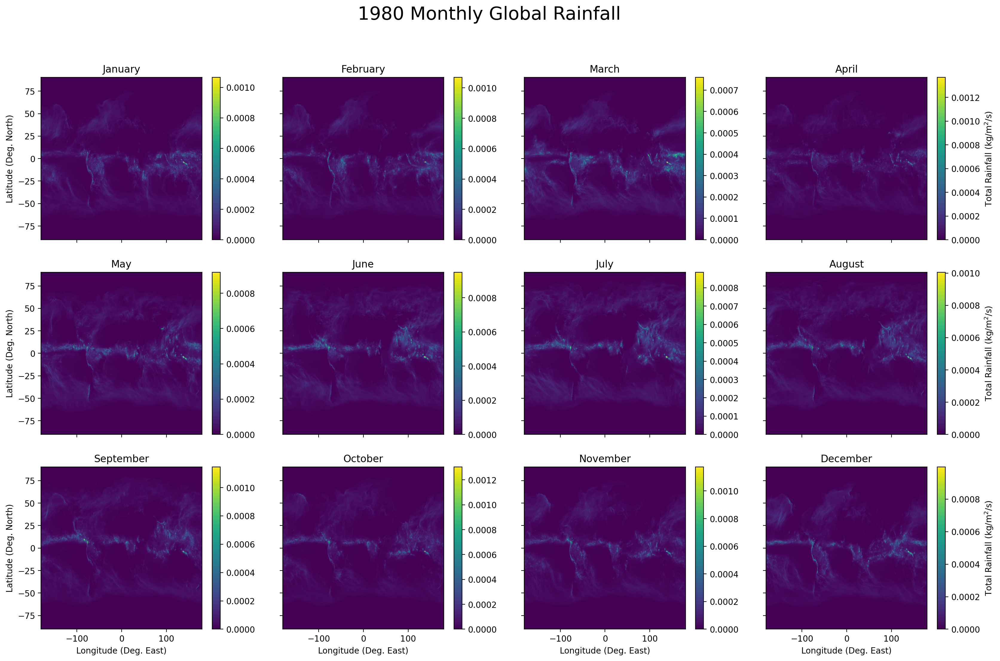

In [6]:
# Update: plot the above 12 plots but all as part of one figure, where I have three rows of four figures each
make_12panel('1980 Monthly Global Rainfall',ds_1980.TOTRAIN,r'Total Rainfall (kg/m$^2$/s)')

Just as a basic validation of this to see if it makes sense, let's consider the Indian monsoon. India is located at about 20 deg. N, 79 deg. E. And NOAA [says](https://www.cpc.ncep.noaa.gov/products/assessments/assess_96/india.html) the Indian monsoon season is approximately June - September. Looking at the plots above, it does look like the rainfall levels in India are going up considerably during this season, so that's a quick piece of evidence that this data is correct. Cool!

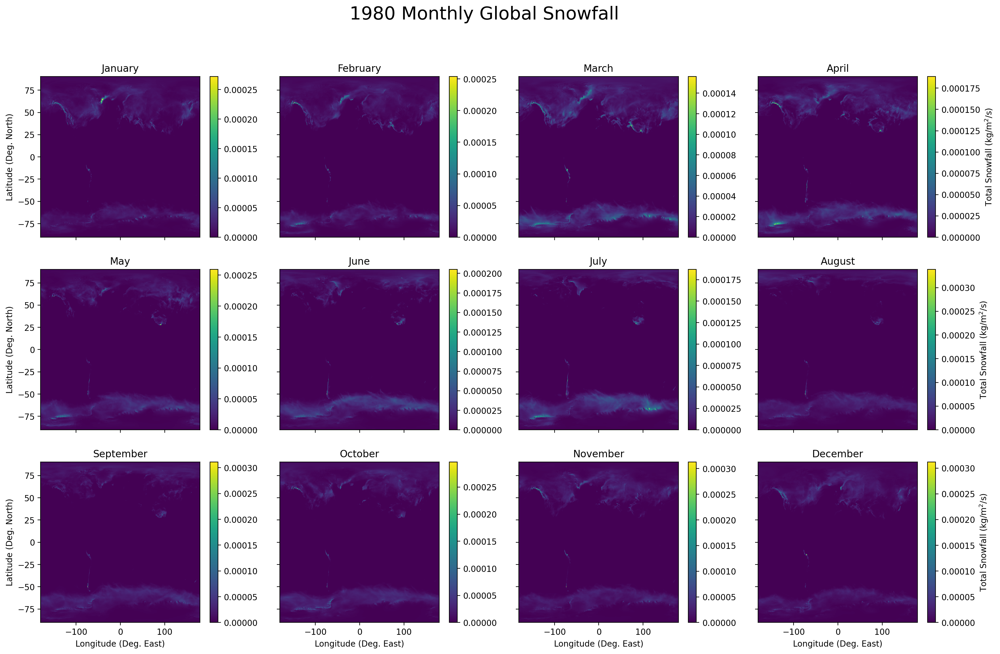

In [7]:
make_12panel('1980 Monthly Global Snowfall',ds_1980.PRECSN,r'Total Snowfall (kg/m$^2$/s)')

In the plots above, snow in the N. Hemisphere seems to follow the trend I would expect (more in JFM, less in JJA). But in the S. Hemisphere it's tougher to tell. The only significant snow there seems to fall in the Andes, and that doesn't seem to vary very coherently with month. 

Let's check out TOA net downward shortwave flux. Naturally I'd expect to see more around the equator year-round, and more in the hemisphere that's currently in summer than the one that's in winter.

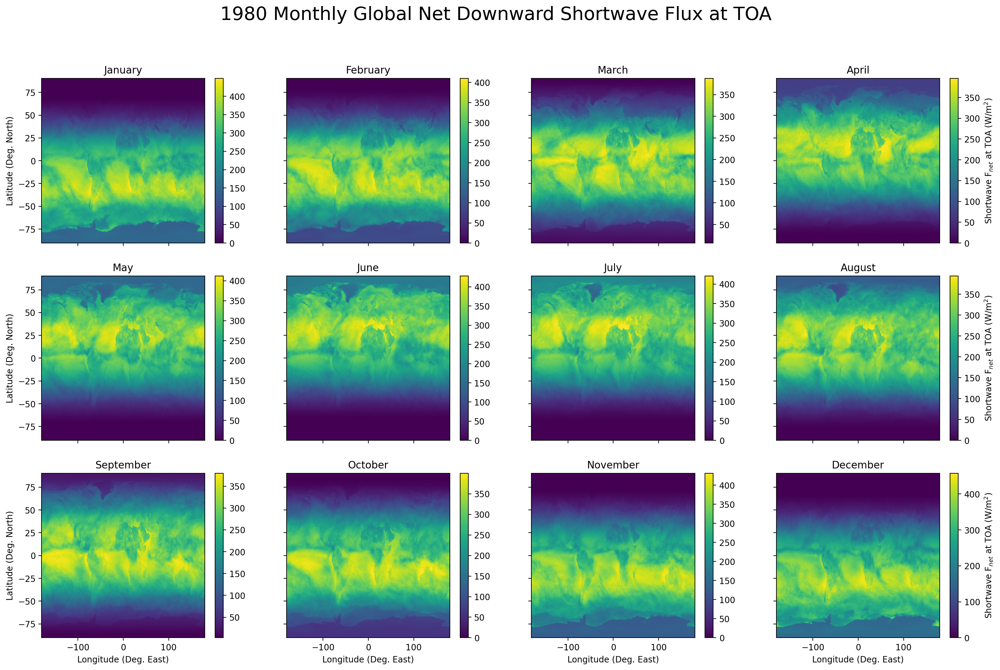

In [8]:
make_12panel('1980 Monthly Global Net Downward Shortwave Flux at TOA',ds_1980.SWNETTOA,r'Shortwave F$_{net}$ at TOA (W/m$^2$)')

Nice - that seasonal cycle is _exactly_ what I would expect to see.

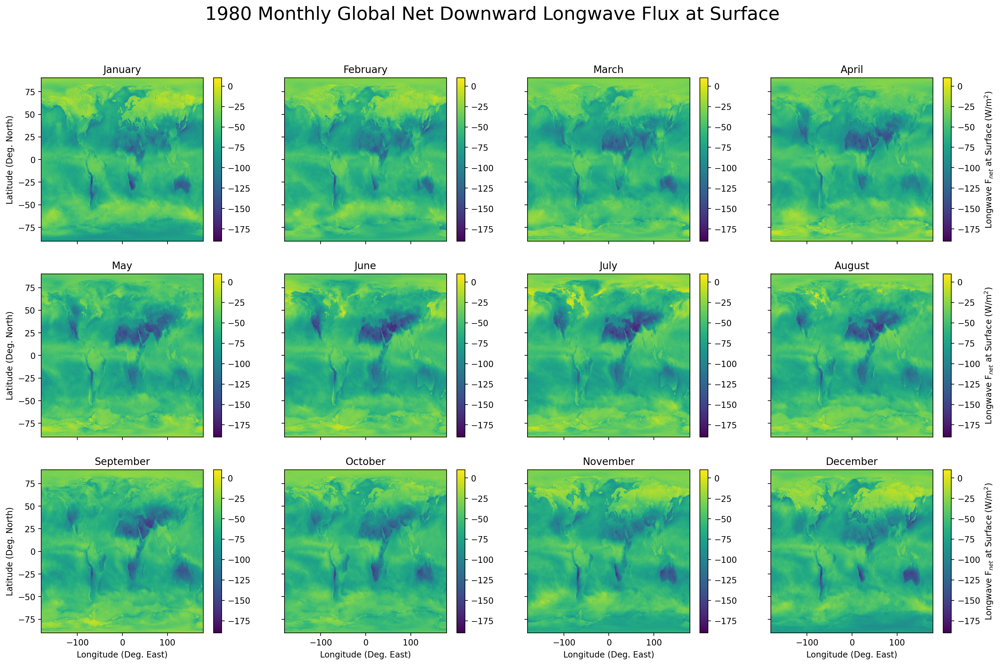

In [9]:
make_12panel('1980 Monthly Global Net Downward Longwave Flux at Surface',ds_1980.LWGNET,r'Longwave F$_{net}$ at Surface (W/m$^2$)','viridis',vmin=-190,vmax=10)

As expected, the net _downward_ LW flux at the ground (above) is negative almost all the time. In fact, July and August are the only months in which it's negative anywhere on Earth.

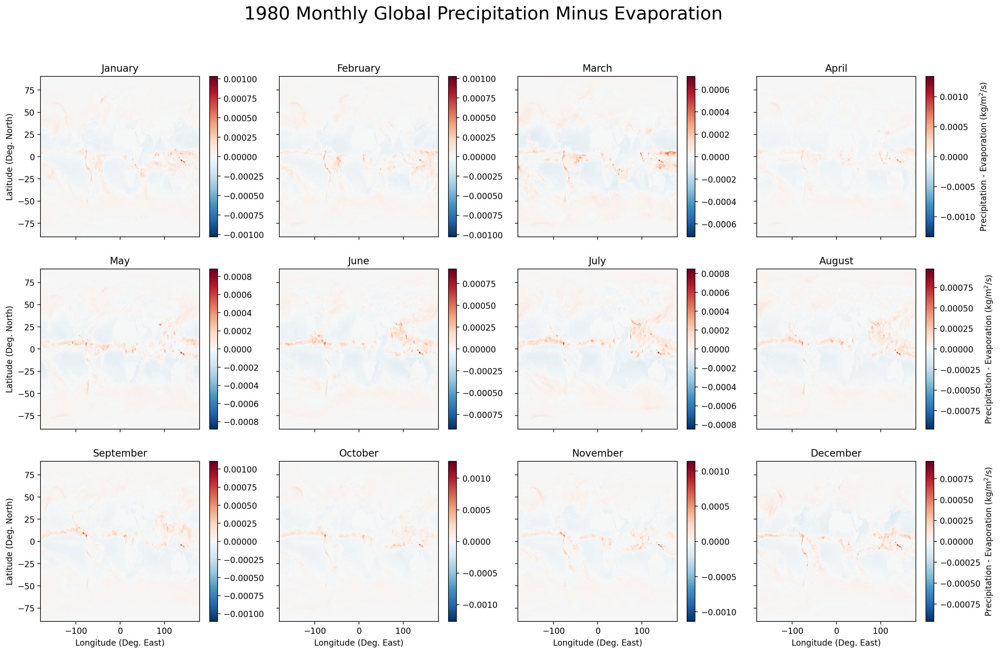

In [10]:
make_12panel('1980 Monthly Global Precipitation Minus Evaporation',(ds_1980.TOTRAIN + ds_1980.PRECSN - ds_1980.EVAP),r'Precipitation - Evaporation (kg/m$^2$/s)')

Precipitation minus evaporation (P-E) is positive in the tropics and negative in the subtropics, which makes sense given what we know about the Hadley cell (i.e., it picks up (evaporates) water from the subtropics and transports it to the tropics, where it rises and rains out). 

All right, I've checked out a few plots and they look like they make sense. Now it's time to try to actually compute the net flux into each column. I'll break this up into three parts: 1) radiation, 2) sensible heat (i.e., conduction between the lower atmosphere and the ground), 3) latent heating (i.e., the positive contribution of evaporation). 

In [11]:
# First: radiation
# I want: - LWGNET - SWNETSRF + SWNETTOA - LWTNET
# This will give me the net flux into the column due to radiation
ds_1980['FNETRAD'] = -ds_1980.LWGNET - ds_1980.SWNETSRF + ds_1980.SWNETTOA - ds_1980.LWTNET
ds_1980

<xarray.Dataset>
Dimensions:   (time: 12, lat: 361, lon: 576)
Coordinates:
  * lat       (lat) float64 -90.0 -89.5 -89.0 -88.5 ... 88.5 89.0 89.5 90.0
  * lon       (lon) float64 -180.0 -179.4 -178.8 -178.1 ... 178.1 178.8 179.4
  * time      (time) datetime64[ns] 1980-01-01T00:30:00 ... 1980-12-01T00:30:00
Data variables:
    EVAP      (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECLS    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    LWTNET    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECCU    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECSN    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    HFLUX     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    SWNETTOA  (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    LWGNET    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    SWNETSRF  (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    TOTRAIN   (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETRAD   (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
Attributes: (12/31)
    DODS_EXTRA.Unlimited_Dimension:    time
    History:                           Original file generated: Thu May  7 23...
    Filename:                          MERRA2_100.tavgM_2d_int_Nx.198001.nc4
    Comment:                           GMAO filename: d5124_m2_jan79.tavg1_2d...
    Conventions:                       CF-1
    Institution:                       NASA Global Modeling and Assimilation ...
    ...                                ...
    DataResolution:                    0.5 x 0.625
    Source:                            CVS tag: GEOSadas-5_12_4
    Contact:                           http://gmao.gsfc.nasa.gov
    identifier_product_doi:            10.5067/FQPTQ4OJ22TL
    RangeBeginningTime:                00:00:00.000000
    RangeEndingTime:                   23:59:59.000000

In [12]:
# Second: sensible heat. Well, I don't have to do anything here because HFLUX is already good to go and measured
# in W/m^2. But I'll just copy that DataArray into a new one called FNETSEN so I'm consistent and clear
ds_1980['FNETSEN'] = ds_1980['HFLUX']
ds_1980

<xarray.Dataset>
Dimensions:   (time: 12, lat: 361, lon: 576)
Coordinates:
  * lat       (lat) float64 -90.0 -89.5 -89.0 -88.5 ... 88.5 89.0 89.5 90.0
  * lon       (lon) float64 -180.0 -179.4 -178.8 -178.1 ... 178.1 178.8 179.4
  * time      (time) datetime64[ns] 1980-01-01T00:30:00 ... 1980-12-01T00:30:00
Data variables:
    EVAP      (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECLS    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    LWTNET    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECCU    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECSN    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    HFLUX     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    SWNETTOA  (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    LWGNET    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    SWNETSRF  (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    TOTRAIN   (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETRAD   (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETSEN   (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
Attributes: (12/31)
    DODS_EXTRA.Unlimited_Dimension:    time
    History:                           Original file generated: Thu May  7 23...
    Filename:                          MERRA2_100.tavgM_2d_int_Nx.198001.nc4
    Comment:                           GMAO filename: d5124_m2_jan79.tavg1_2d...
    Conventions:                       CF-1
    Institution:                       NASA Global Modeling and Assimilation ...
    ...                                ...
    DataResolution:                    0.5 x 0.625
    Source:                            CVS tag: GEOSadas-5_12_4
    Contact:                           http://gmao.gsfc.nasa.gov
    identifier_product_doi:            10.5067/FQPTQ4OJ22TL
    RangeBeginningTime:                00:00:00.000000
    RangeEndingTime:                   23:59:59.000000

In [13]:
# Third: latent heat. 
# Recall that Lv depends on temperature - I'll use the one I found for 0.01 deg. C here:
# https://thermopedia.com/content/1150/
Lv = 2500.5e3 # latent heat of vaporization for water at 0 deg. C; J/kg
ds_1980['FNETLAT'] = Lv * ds_1980.EVAP
ds_1980

<xarray.Dataset>
Dimensions:   (time: 12, lat: 361, lon: 576)
Coordinates:
  * lat       (lat) float64 -90.0 -89.5 -89.0 -88.5 ... 88.5 89.0 89.5 90.0
  * lon       (lon) float64 -180.0 -179.4 -178.8 -178.1 ... 178.1 178.8 179.4
  * time      (time) datetime64[ns] 1980-01-01T00:30:00 ... 1980-12-01T00:30:00
Data variables: (12/13)
    EVAP      (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECLS    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    LWTNET    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECCU    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECSN    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    HFLUX     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    ...        ...
    LWGNET    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    SWNETSRF  (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    TOTRAIN   (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETRAD   (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETSEN   (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETLAT   (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
Attributes: (12/31)
    DODS_EXTRA.Unlimited_Dimension:    time
    History:                           Original file generated: Thu May  7 23...
    Filename:                          MERRA2_100.tavgM_2d_int_Nx.198001.nc4
    Comment:                           GMAO filename: d5124_m2_jan79.tavg1_2d...
    Conventions:                       CF-1
    Institution:                       NASA Global Modeling and Assimilation ...
    ...                                ...
    DataResolution:                    0.5 x 0.625
    Source:                            CVS tag: GEOSadas-5_12_4
    Contact:                           http://gmao.gsfc.nasa.gov
    identifier_product_doi:            10.5067/FQPTQ4OJ22TL
    RangeBeginningTime:                00:00:00.000000
    RangeEndingTime:                   23:59:59.000000

All right - now I just need to add up the three F$_{net}$s to get the total F$_{net}$ into each column.

In [14]:
ds_1980['FNETTOTAL'] = ds_1980['FNETRAD'] + ds_1980['FNETSEN'] + ds_1980['FNETLAT']
ds_1980

<xarray.Dataset>
Dimensions:    (time: 12, lat: 361, lon: 576)
Coordinates:
  * lat        (lat) float64 -90.0 -89.5 -89.0 -88.5 ... 88.5 89.0 89.5 90.0
  * lon        (lon) float64 -180.0 -179.4 -178.8 -178.1 ... 178.1 178.8 179.4
  * time       (time) datetime64[ns] 1980-01-01T00:30:00 ... 1980-12-01T00:30:00
Data variables: (12/14)
    EVAP       (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECLS     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    LWTNET     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECCU     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECSN     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    HFLUX      (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    ...         ...
    SWNETSRF   (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    TOTRAIN    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETRAD    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETSEN    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETLAT    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETTOTAL  (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
Attributes: (12/31)
    DODS_EXTRA.Unlimited_Dimension:    time
    History:                           Original file generated: Thu May  7 23...
    Filename:                          MERRA2_100.tavgM_2d_int_Nx.198001.nc4
    Comment:                           GMAO filename: d5124_m2_jan79.tavg1_2d...
    Conventions:                       CF-1
    Institution:                       NASA Global Modeling and Assimilation ...
    ...                                ...
    DataResolution:                    0.5 x 0.625
    Source:                            CVS tag: GEOSadas-5_12_4
    Contact:                           http://gmao.gsfc.nasa.gov
    identifier_product_doi:            10.5067/FQPTQ4OJ22TL
    RangeBeginningTime:                00:00:00.000000
    RangeEndingTime:                   23:59:59.000000

Cool - now let me take the zonal mean of FNETTOTAL and I'll have the net flux into each latitude band. 

In [15]:
ds_1980['FNETZONAL'] = ds_1980.FNETTOTAL.mean('lon')
ds_1980

<xarray.Dataset>
Dimensions:    (time: 12, lat: 361, lon: 576)
Coordinates:
  * lat        (lat) float64 -90.0 -89.5 -89.0 -88.5 ... 88.5 89.0 89.5 90.0
  * lon        (lon) float64 -180.0 -179.4 -178.8 -178.1 ... 178.1 178.8 179.4
  * time       (time) datetime64[ns] 1980-01-01T00:30:00 ... 1980-12-01T00:30:00
Data variables: (12/15)
    EVAP       (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECLS     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    LWTNET     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECCU     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    PRECSN     (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    HFLUX      (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    ...         ...
    TOTRAIN    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETRAD    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETSEN    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETLAT    (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETTOTAL  (time, lat, lon) float32 dask.array<chunksize=(12, 361, 576), meta=np.ndarray>
    FNETZONAL  (time, lat) float32 dask.array<chunksize=(12, 361), meta=np.ndarray>
Attributes: (12/31)
    DODS_EXTRA.Unlimited_Dimension:    time
    History:                           Original file generated: Thu May  7 23...
    Filename:                          MERRA2_100.tavgM_2d_int_Nx.198001.nc4
    Comment:                           GMAO filename: d5124_m2_jan79.tavg1_2d...
    Conventions:                       CF-1
    Institution:                       NASA Global Modeling and Assimilation ...
    ...                                ...
    DataResolution:                    0.5 x 0.625
    Source:                            CVS tag: GEOSadas-5_12_4
    Contact:                           http://gmao.gsfc.nasa.gov
    identifier_product_doi:            10.5067/FQPTQ4OJ22TL
    RangeBeginningTime:                00:00:00.000000
    RangeEndingTime:                   23:59:59.000000

In [16]:
# Let's plot FNETZONAL in the time mean over the year 1980
# Need to normalize by length of each month
# TODO: Might need to define a new 'month' coord and use that instead of ds_1980.time
month_lengths = xr.DataArray([31,28,31,30,31,30,31,31,30,31,30,31],coords=[ds_1980.time]) # Ignore leap years
fnetzonal_weighted = ds_1980.FNETZONAL.weighted(month_lengths)
fnetzonal_weighted_mean = fnetzonal_weighted.mean('time')
fnetzonal_weighted_mean

<xarray.DataArray 'FNETZONAL' (lat: 361)>
dask.array<truediv, shape=(361,), dtype=float64, chunksize=(361,), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -89.5 -89.0 -88.5 -88.0 ... 88.5 89.0 89.5 90.0

Text(0.5, 1.0, 'Net Flux Into the Atmospheric Column, Zonal Mean')

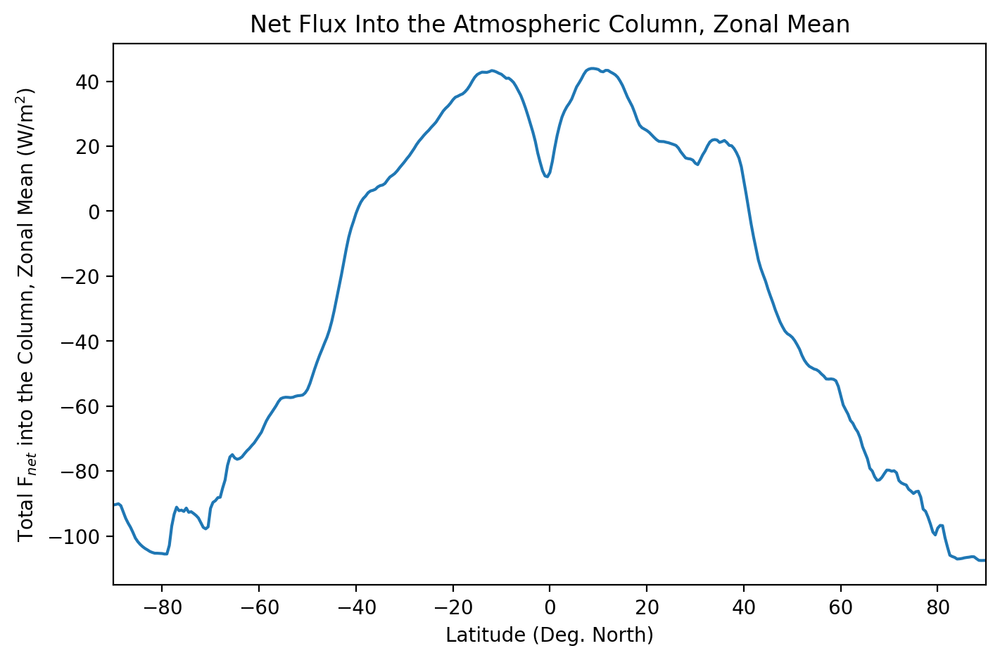

In [44]:
fig, ax = plt.subplots(figsize=(8,5))
fnetzonal_weighted_mean.plot()
plt.xlabel('Latitude (Deg. North)')
plt.ylabel(r'Total F$_{net}$ into the Column, Zonal Mean (W/m$^2$)')
plt.xlim(-90,90)
plt.title('Net Flux Into the Atmospheric Column, Zonal Mean')
# TODO: Add text label for ITCZ as the central dip here

Now I have the zonal mean of the net energy flux into the column. Assuming steady state, I know this flux will flow meridionally. But how do I know whether it's going to flow north or south? 

We take advantage of a really simple mathematical reality. What I have in the plot of FNETZONAL above is the amount of energy per second that needs to be transported meridionally out of each latitude band in order to preserve steady state. Picture 2 atmospheric columns next to each other - call them column 1 and column 2, in the N. Hemi, with column 1 at a lower latitude. If column 1 has a greater F$_{net}$ than column 2, then yes, they both need to lose energy, but column 1 is going to lose more energy to column 2 than column 2 is going to lose to column 1. So it's really the _derivative_ $\frac{dF}{dy}$ that determines the flow of the "excess" energy - it will flow from higher to lower concentration. To get the actual power transported northward through each latitude (measured in W), we can do a weighted integral of $\frac{dF}{dy}$ where the weights account for the fact that latitude bands closer to the poles cover less area than those closer to the equator (this is important when converting from W/m$^2$ to W). 

OK, so now I should be able to integrate FNETZONAL, weighted by the "area" of each latitude band, which would come from spherical geometry. We can use Eq. (A4) from [Hill, Ming, & Held (2014)](https://www.ldeo.columbia.edu/~shill/papers/hill+2015_full_with_corr.pdf) as an example; their $Q_{TOA} - Q_{sfc}$ is my $F_{net,\ tot}$, and their $a$ is the radius of the Earth:

$$F_{tot}(\phi) = \int_{-\pi/2}^{\phi}\int_{0}^{2\pi}(Q_\text{TOA}-Q_\text{sfc})a^2cos\phi\ d\lambda\ d\phi.$$

In [32]:
# Weight by the "area" of each latitude band, and don't forget to convert from degrees to radians
lat_weights = np.cos(np.deg2rad(fnetzonal_weighted_mean.lat))
lat_weights.name = 'lat_weights'

In [19]:
fnetzonal_weighted_mean_weighted_lat = fnetzonal_weighted_mean * lat_weights
fnetzonal_weighted_mean_weighted_lat

<xarray.DataArray (lat: 361)>
dask.array<mul, shape=(361,), dtype=float64, chunksize=(361,), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -89.5 -89.0 -88.5 -88.0 ... 88.5 89.0 89.5 90.0

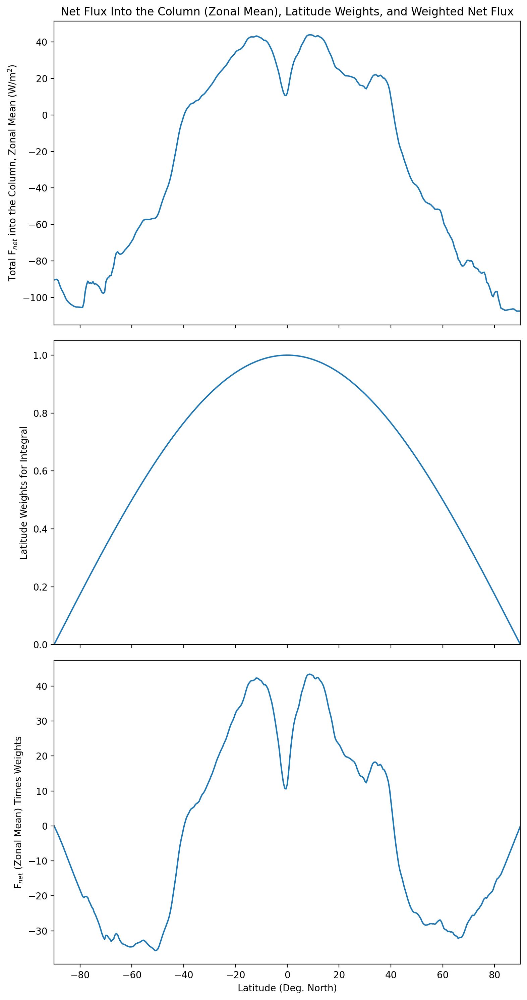

In [47]:
# Three-panel plot with the 1) F_net zonal mean annual mean, 2) weights for each latitude, 3) product of 1 and 2
fig, ax = plt.subplots(nrows=3,ncols=1,figsize=(8,15),sharex='col')
plt.xlim(-90,90)
fnetzonal_weighted_mean.plot(ax=ax[0])
ax[0].set_xlabel('')
ax[0].set_ylabel(r'Total F$_{net}$ into the Column, Zonal Mean (W/m$^2$)')
ax[0].set_title('Net Flux Into the Column (Zonal Mean), Latitude Weights, and Weighted Net Flux')
lat_weights.plot(ax=ax[1])
ax[1].set_xlabel('')
ax[1].set_ylabel('Latitude Weights for Integral')
ax[1].set_ylim(0,1.05)
fnetzonal_weighted_mean_weighted_lat.plot(ax=ax[2])
ax[2].set_xlabel('')
ax[2].set_ylabel(r'F$_{net}$ (Zonal Mean) Times Weights')
plt.xlabel('Latitude (Deg. North)')
plt.tight_layout()

Notice that the weights have significantly reduced the magnitude of the negative $F_{net}$ values near the poles - this makes sense, because there's comparatively little area in these latitude bands.

Now the last thing I want to do is integrate the curve in the bottom panel of the previous plot according to Eq. (A4) above to get a net northward energy transport at every latitude.

Text(0.5, 1.0, 'Northward Implied Moist Static Energy Flux')

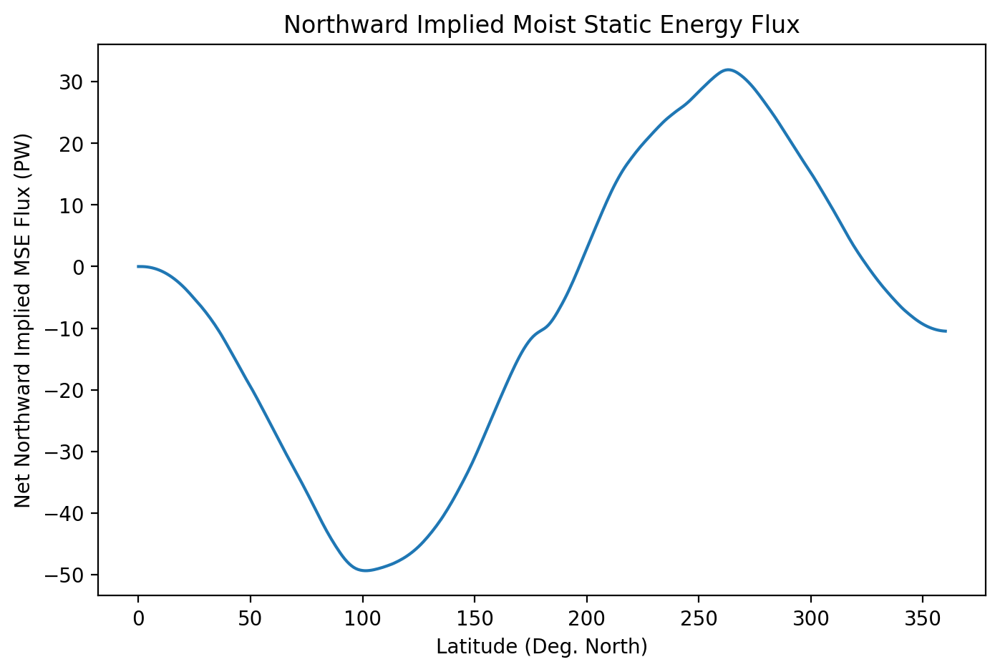

In [48]:
# TODO: This cell takes a while to run - that could be an issue. Can make it more efficient by not doing the
# whole trapz integral every time - just add on the next step and keep a running sum
net_northward_transport = []
a = 6.378e6 # Radius of the Earth in m
for i in range(len(fnetzonal_weighted_mean_weighted_lat)):
    net_northward_transport.append(a**2 * fnetzonal_weighted_mean_weighted_lat[:i].integrate('lat'))
net_northward_transport = xr.DataArray(np.array(net_northward_transport))
fig, ax = plt.subplots(figsize=(8,5))
(net_northward_transport/1e15).plot()
plt.xlabel('Latitude (Deg. North)')
plt.ylabel('Net Northward Implied MSE Flux (PW)')
plt.title('Northward Implied Moist Static Energy Flux')

This seems to be off by close to a factor of 2$\pi$ from what we see in, for example, [Vellinga & Wu (2008)](https://journals.ametsoc.org/view/journals/clim/21/3/2007jcli1754.1.xml)...

## References

1. Hill, S. A., Ming, Y., & Held, I. M., 2015. "Mechanisms of Forced Tropical Meridional Energy Flux Change." _J. Clim._, 28, 1725-1742. 
2. Kiranmayi, L., & Maloney, E. D., 2011. "Intraseasonal Moist Static Energy Budget in Reanalysis Data." _J. Geophys. Res._, 116, D21117.
3. Vellinga, M., & Wu, P., 2008. "Relations between Northward Ocean and Atmosphere Energy Transports in a Coupled Climate Model." _J. Clim._, 21, 561-575.